
## a) Generate a sine wave, add noise to it, and then perform convolution with a smoothing filter to reduce noise. Make your code general, so that it takes the filter from the user.

Enter the filter (average, bw, median): bw


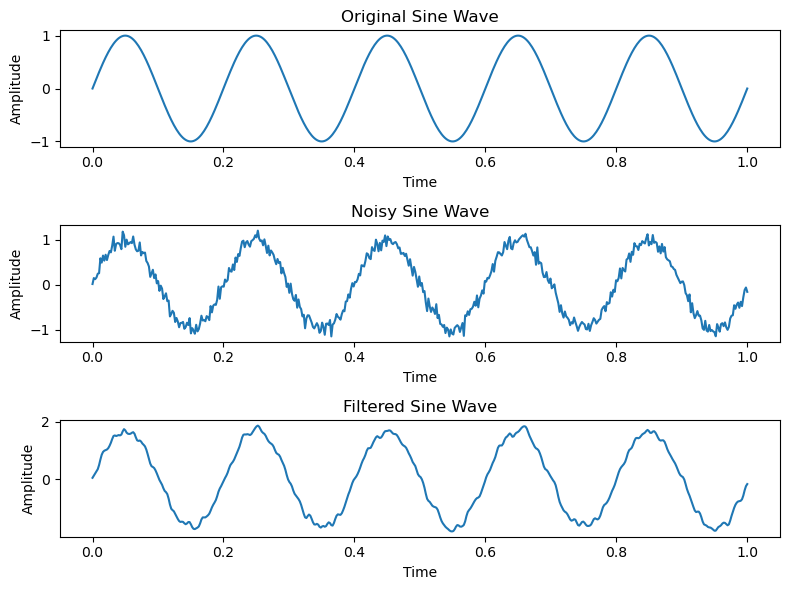

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp

def generate_noisy_signal(N: float = 1, samples: int = 100, F: int = 5, LEVEL: float = 0.1):
    time = np.linspace(start=0, stop=1, num=samples)  # Time Axis
    sine = np.sin(N * np.pi * F * time)  # Sine Wave
    noise = np.random.randn(samples)  # Noise
    noisy_signal = sine + LEVEL * noise  # Noisy Sine Signal
    return noisy_signal, sine, time

def get_average_filter(window_size: int):
    return np.ones(window_size) / window_size

def get_butterworth_filter(order, cut_off):
    return sp.signal.butter(N=order, Wn=cut_off)

def main():
    name = input("Enter the filter (average, bw, median): ")

    if name == "average":
        signal_filter = get_average_filter(window_size=5)
    elif name == "bw":
        a, b = get_butterworth_filter(order=5, cut_off=0.5)
        signal_filter = a / b[0]
    elif name == "median":
        signal_filter = sp.signal.medfilt(volume=sine_signal, kernel_size=5)
    else:
        print("Enter a valid filter!")
        return

    noisy_signal, sine_signal, time = generate_noisy_signal(N=5, samples=500, F=2, LEVEL=0.1)

    # Apply the chosen filter
    filtered_signal = np.convolve(noisy_signal, signal_filter, mode="same")

    # Plotting
    plt.figure(figsize=(8, 6))
    plt.subplot(3, 1, 1)
    plt.plot(time, sine_signal, label='Original Sine Wave')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Original Sine Wave')

    plt.subplot(3, 1, 2)
    plt.plot(time, noisy_signal, label='Noisy Signal')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Noisy Sine Wave')

    plt.subplot(3, 1, 3)
    plt.plot(time, filtered_signal, label='Filtered Signal')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Filtered Sine Wave')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    main()

    

## b) For the given ECG signals  compute and show the location of the R peak.

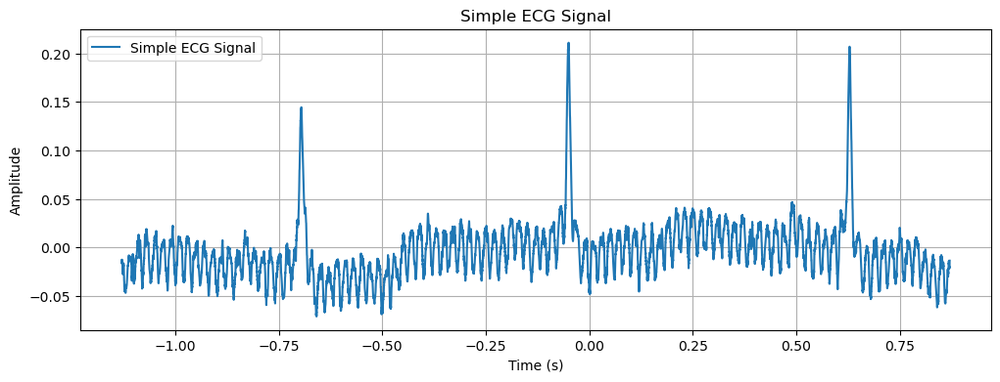

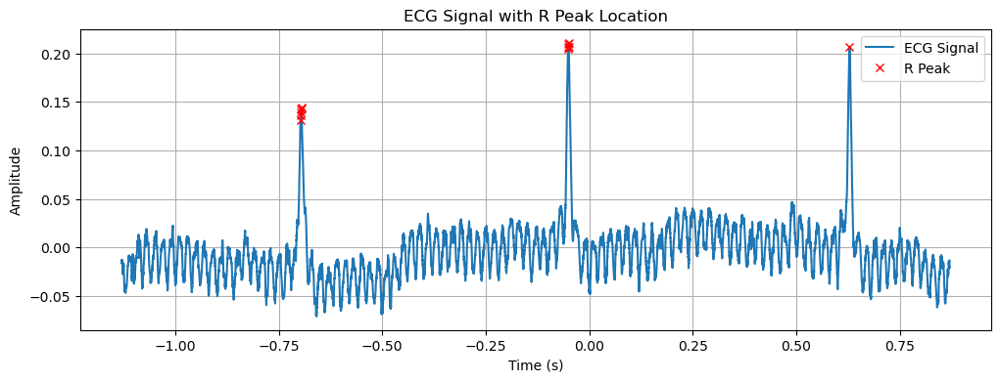

In [58]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import ifft, fft
import pandas as pd

# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()


## c) Add noise to the ECG signal, and filter in the frequency domain such that the R peak is largely preserved.

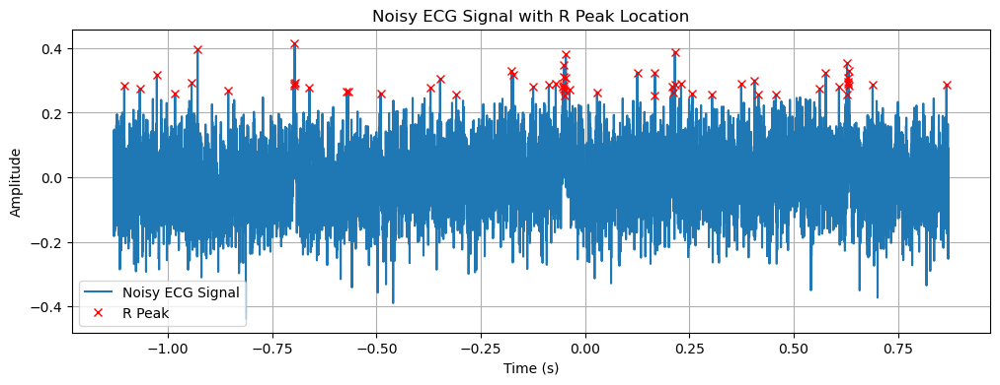

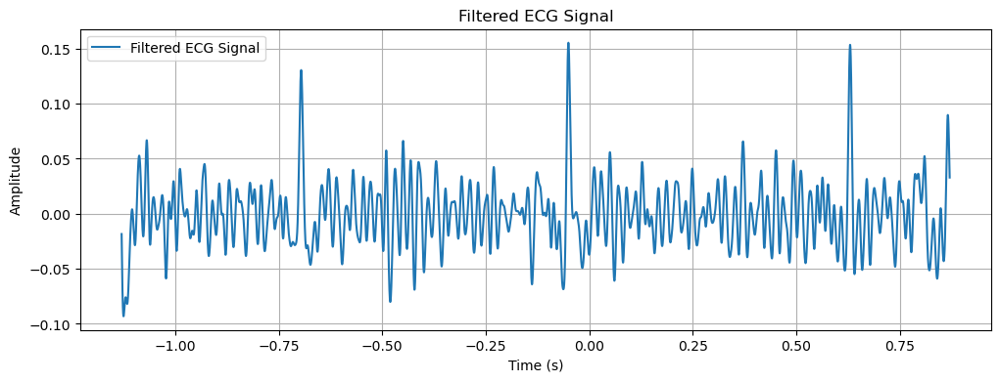

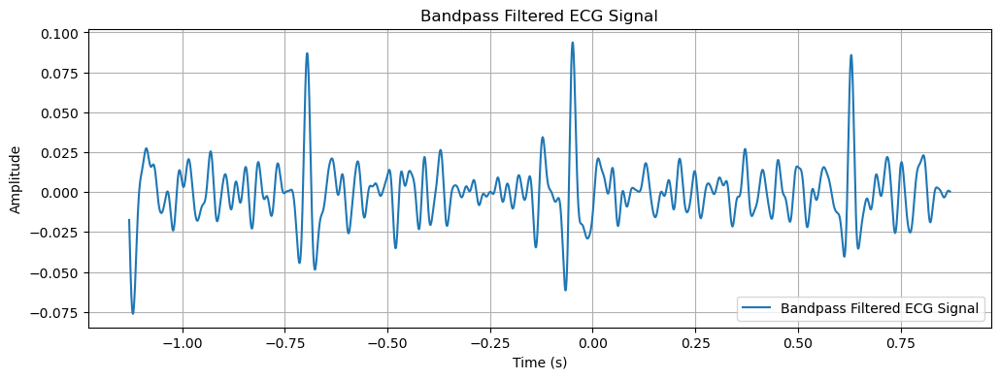

/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


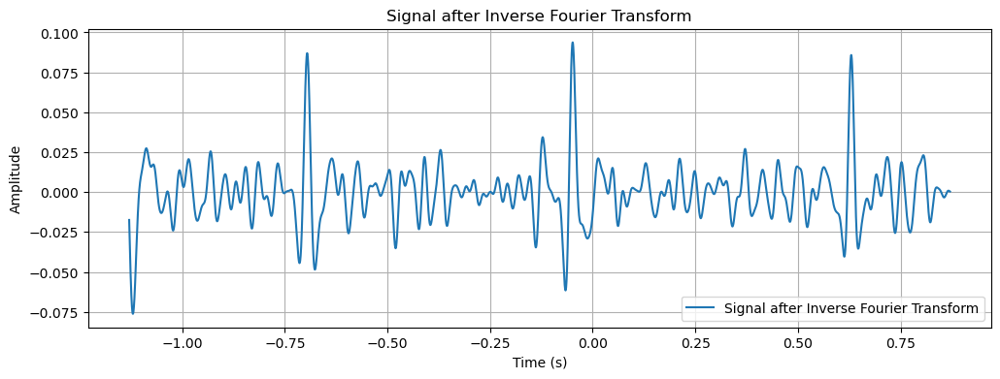

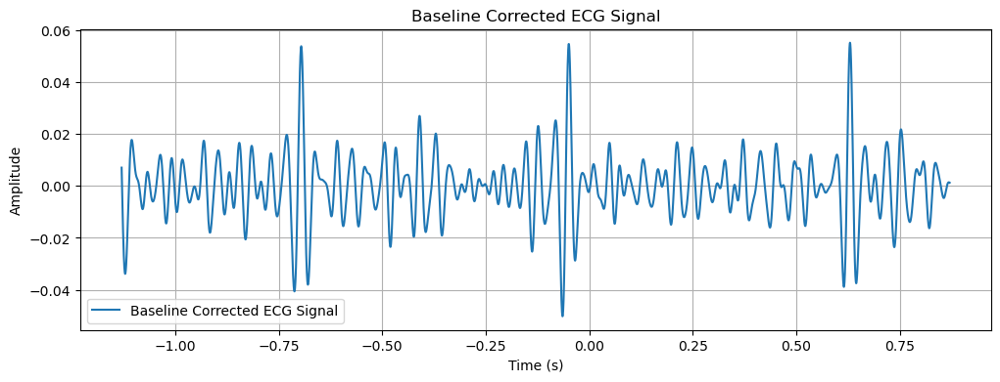

/home/nalin/anaconda3/lib/python3.9/site-packages/scipy/signal/_peak_finding.py:266: ComplexWarning: Casting complex values to real discards the imaginary part
  value = np.asarray(value, order='C', dtype=np.float64)
/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


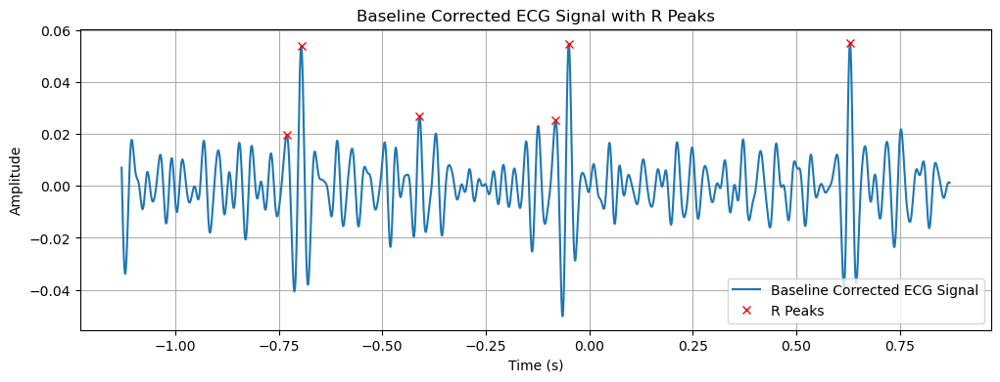

In [59]:

# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))


# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6 * np.max(noisy_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.plot(time[peaks], noisy_ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()


# Butterworth filter
def butterworth_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the Butterworth filter to the noisy ECG signal
filtered_ecg = butterworth_filter(noisy_ecg, low_cut=10, high_cut=80, Fs=1/(time[1]-time[0]))

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Bandpass filtering
def bandpass_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the bandpass filter to the filtered ECG signal
bandpass_filtered_ecg = bandpass_filter(filtered_ecg, low_cut=10, high_cut=40, Fs=1/(time[1]-time[0]))

# Plot the bandpass filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, bandpass_filtered_ecg, label='Bandpass Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Bandpass Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Inverse Fourier Transform
fft_filtered_ecg = fft(bandpass_filtered_ecg)
inverse_fft_filtered_ecg = ifft(fft_filtered_ecg)

# Plot the signal after inverse Fourier Transform
plt.figure(figsize=(12, 4))
plt.plot(time, inverse_fft_filtered_ecg, label='Signal after Inverse Fourier Transform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Signal after Inverse Fourier Transform')
plt.legend()
plt.grid(True)
plt.show()

# Base-line correction
def baseline_correction(signal, window_size):
    b, a = butter(N=5, Wn=0.01, btype='high')
    return filtfilt(b, a, signal)

baseline_corrected_ecg = baseline_correction(inverse_fft_filtered_ecg, window_size=5)

# Plot the baseline corrected ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Find R Peaks
THETA = 0.9
peaks_corrected, _ = find_peaks(x=baseline_corrected_ecg, prominence=THETA * np.max(baseline_corrected_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.plot(time[peaks_corrected], baseline_corrected_ecg[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal with R Peaks')
plt.legend()
plt.grid(True)
plt.show()


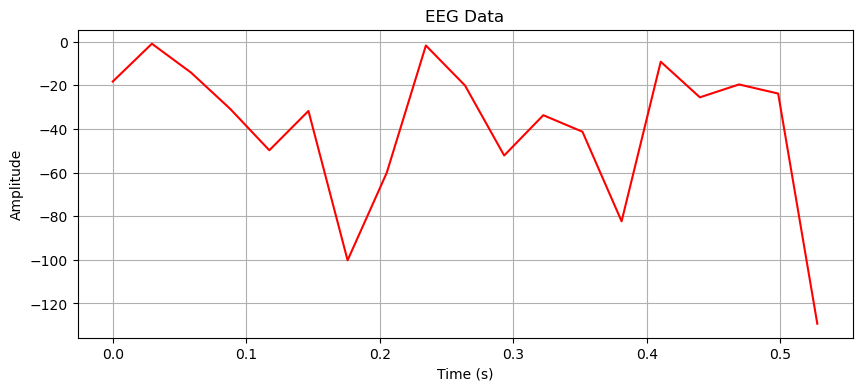

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Load EEG data from the file
file_path = '/home/nalin/Downloads/eeg_data_files-20240411/57_00002656_none_montage_False.npy'
eeg_data = np.load(file_path)

# Transpose the EEG data to read rows instead of columns
eeg_data = eeg_data.T

# Assuming the data is sampled at a constant frequency
# You may need additional information about the sampling rate from the data provider
# For this example, let's assume a sampling rate of 256 Hz
sampling_rate = 36
num_samples = eeg_data.shape[1]  # Note the change here
duration = num_samples / sampling_rate
time = np.linspace(0, duration, num_samples)

# Plot EEG data
plt.figure(figsize=(10, 4))
plt.plot(time, eeg_data[0], "r-")  # Plotting the first row/channel
plt.title('EEG Data')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


## Given EEG data files, filter the signals to get the output in the frequency ranges as

  ##  Delta

  ## Theta

  ## Alpha

## Beta Plot both the time and frequency domains of the input and output signals in each case. Also plot the filters that you used in the frequency domain.


## Single plots

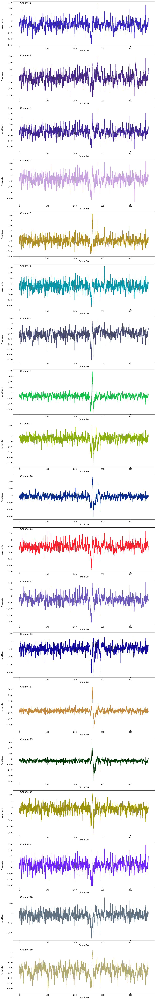

In [52]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, irfft, rfftfreq

# Load EEG data
eeg = np.load('/home/nalin/Downloads/eeg_data_files-20240411/57_00002656_none_montage_False.npy')
eeg_array = np.asarray(eeg)

# Get number of channels and time points
num_channels, num_time_points = eeg_array.shape
time = np.arange(num_time_points) / 100.0

# Plot EEG data for each channel
fig, axs = plt.subplots(num_channels, 1, figsize=(12, 4 * num_channels))
for channel in range(num_channels):
    axs[channel].plot(time, eeg_array[channel, :], c=np.random.rand(3))
    axs[channel].set_ylabel(f'Amplitude', labelpad=20)
    axs[channel].set_xlabel('Time in Sec')
    axs[channel].text(0.05, 0.95, f'Channel {channel + 1}', transform=axs[channel].transAxes, fontsize=12)
plt.tight_layout()
plt.show()

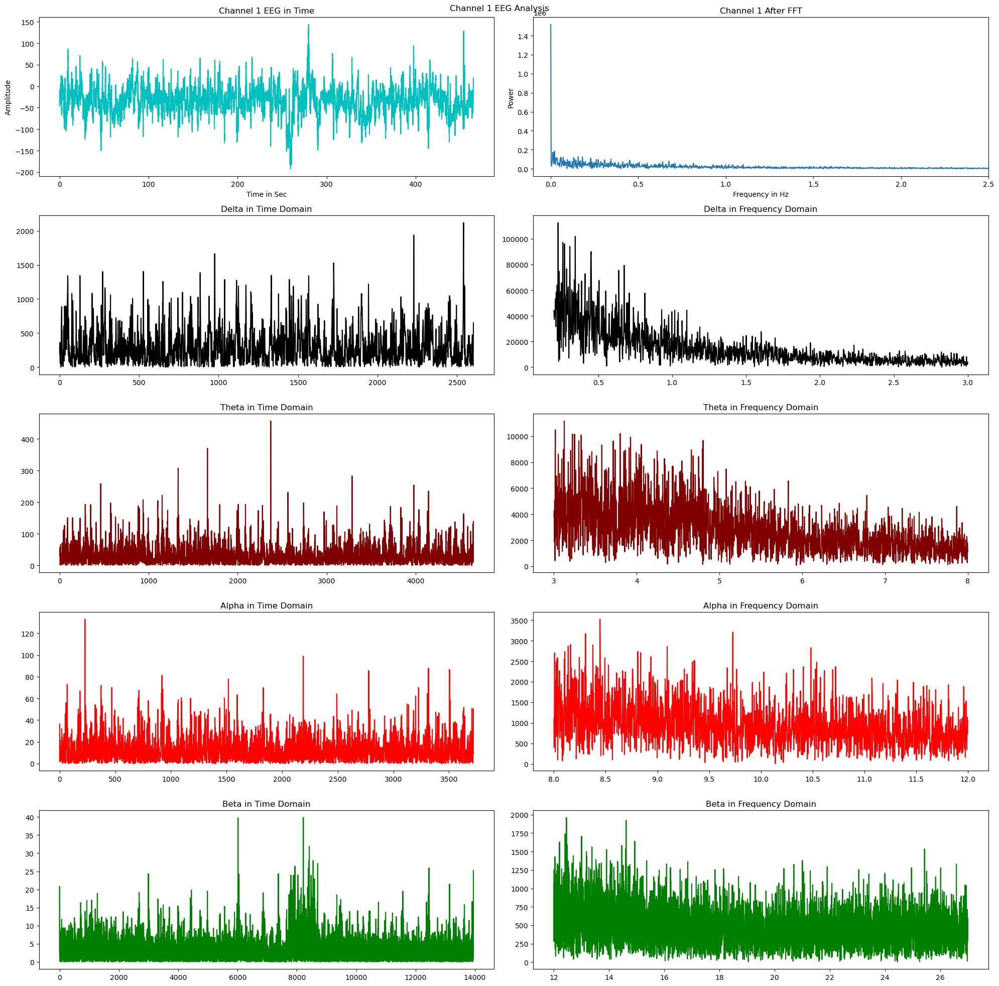

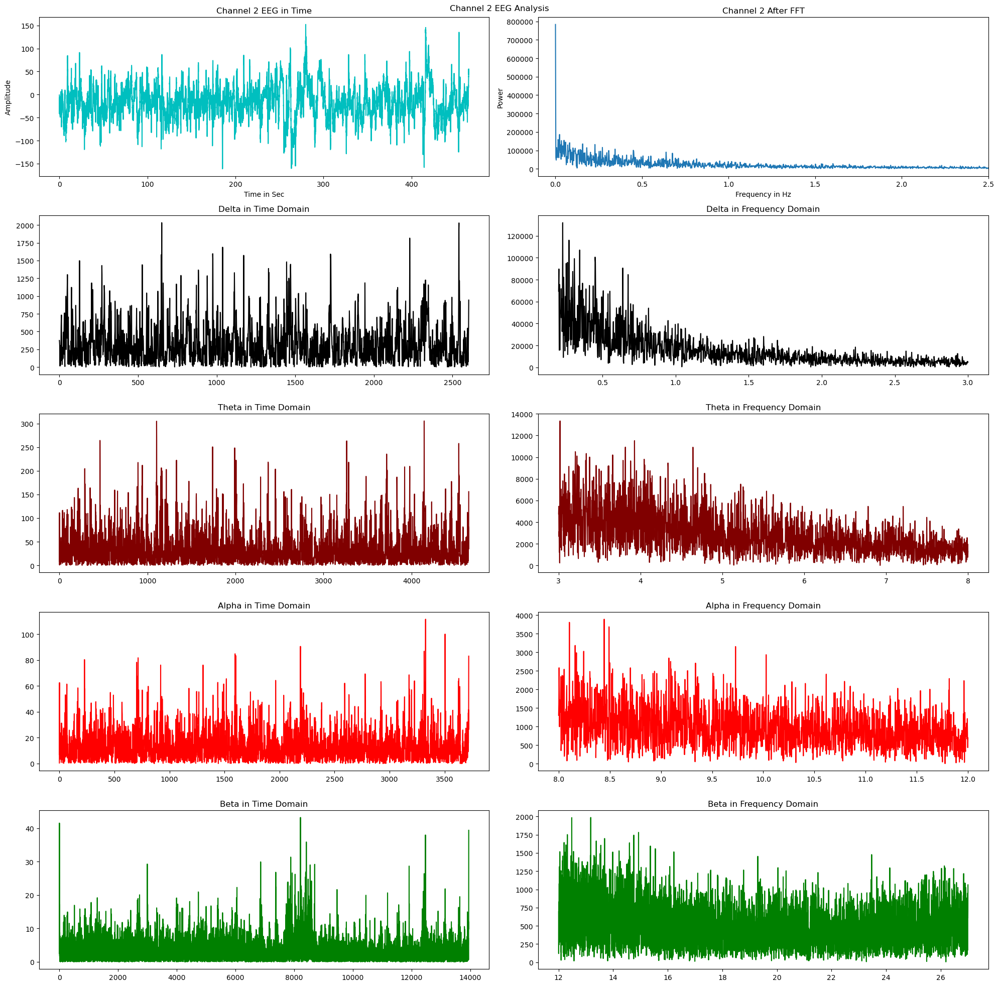

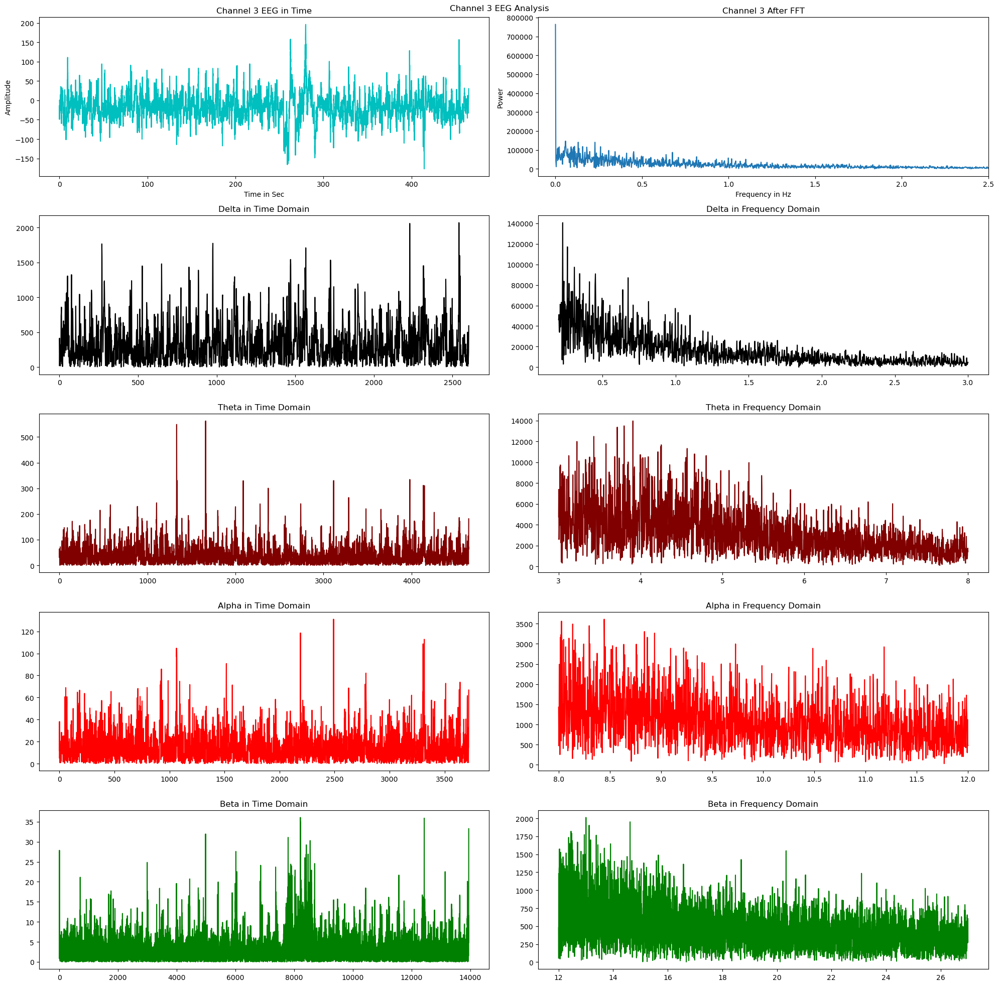

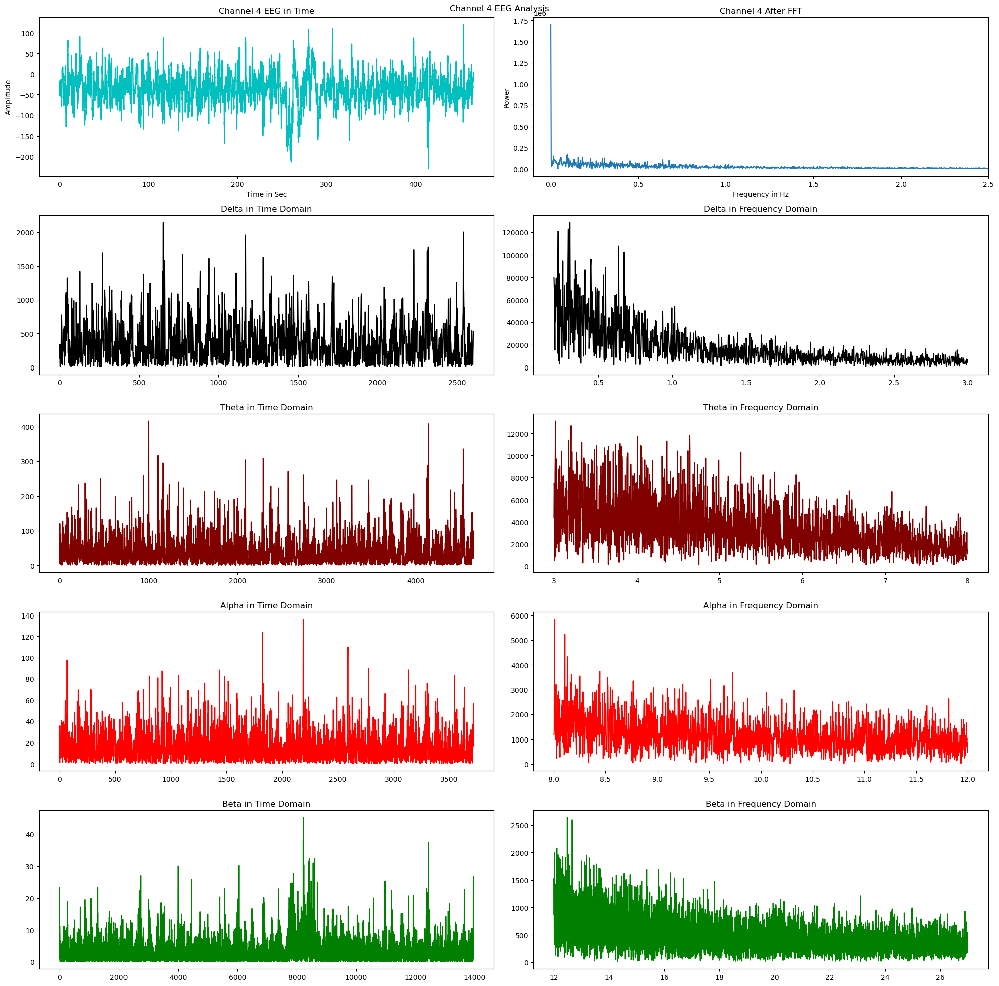

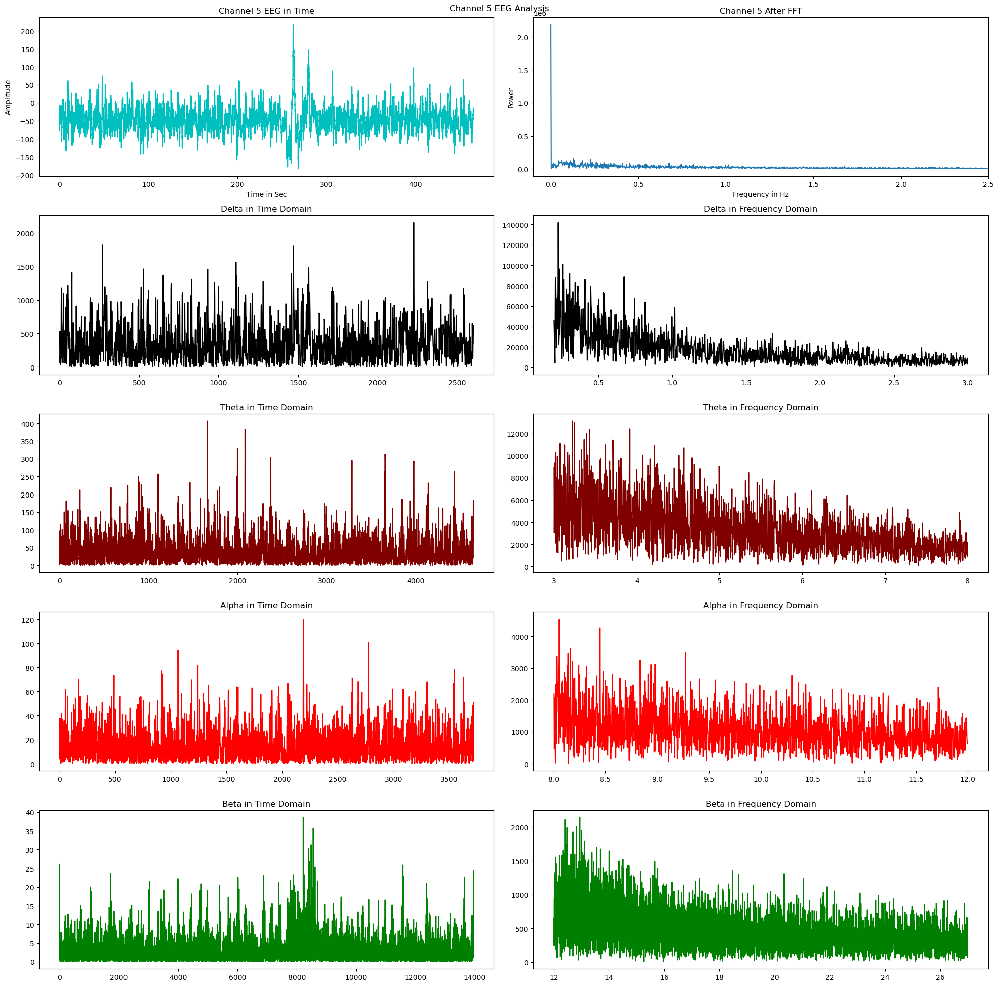

...

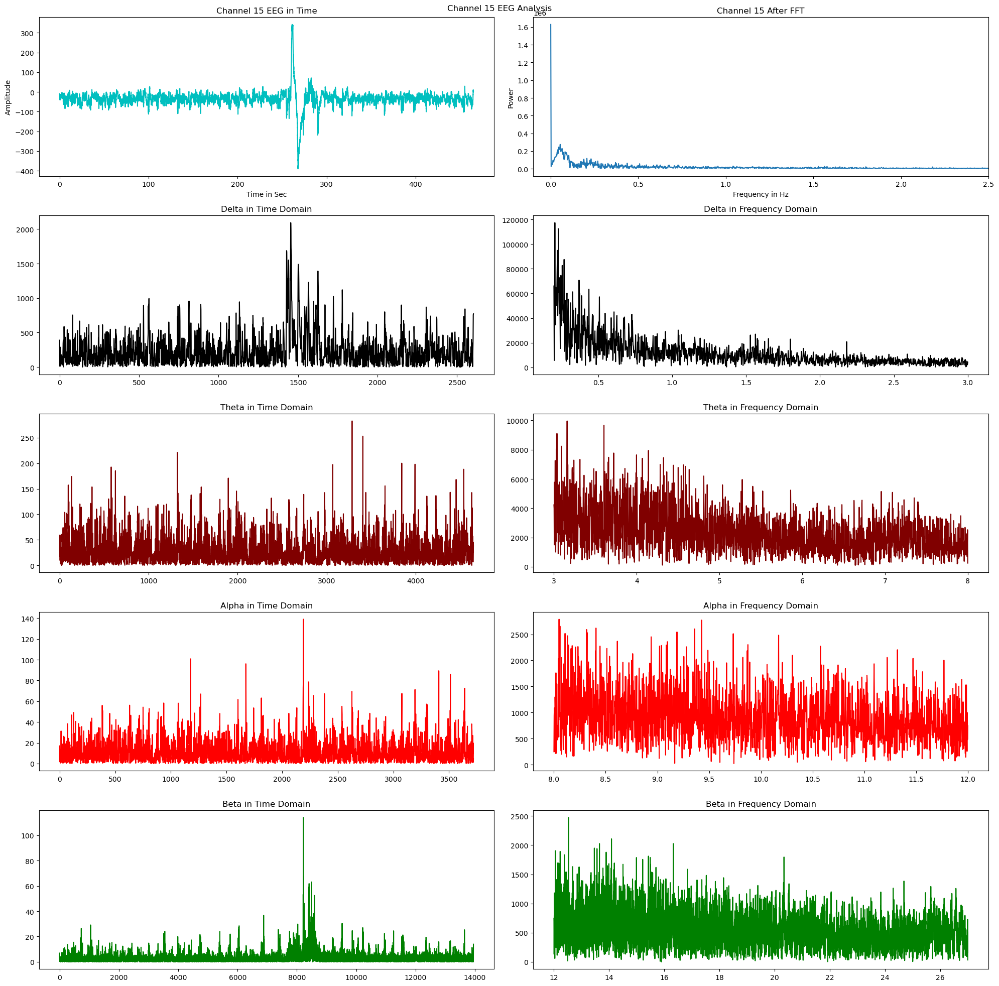

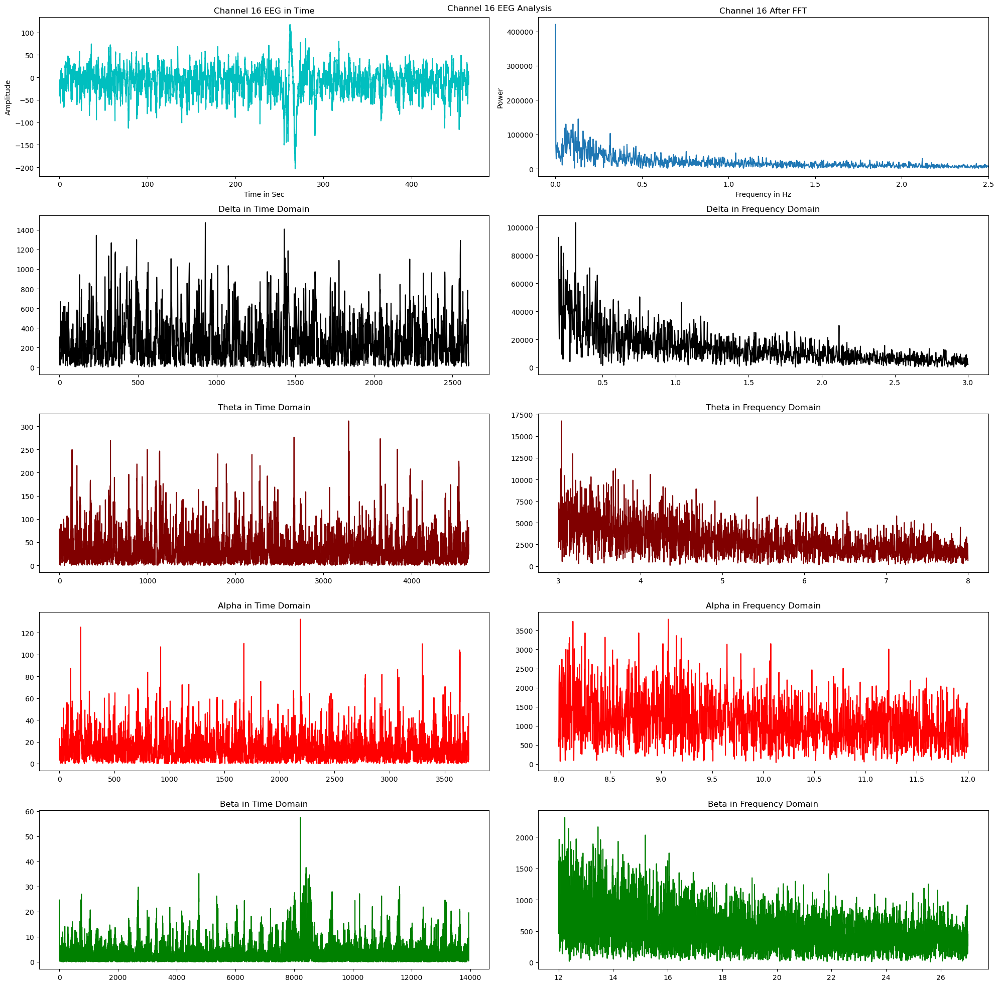

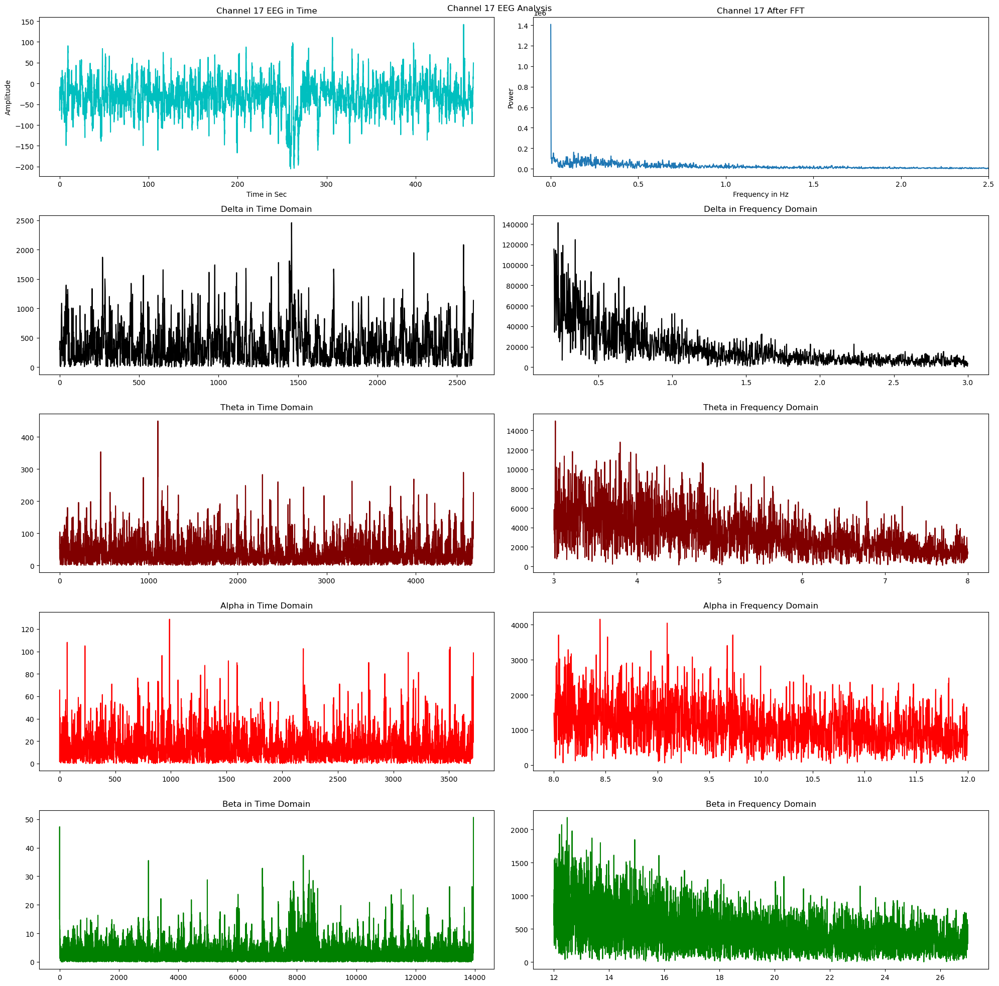

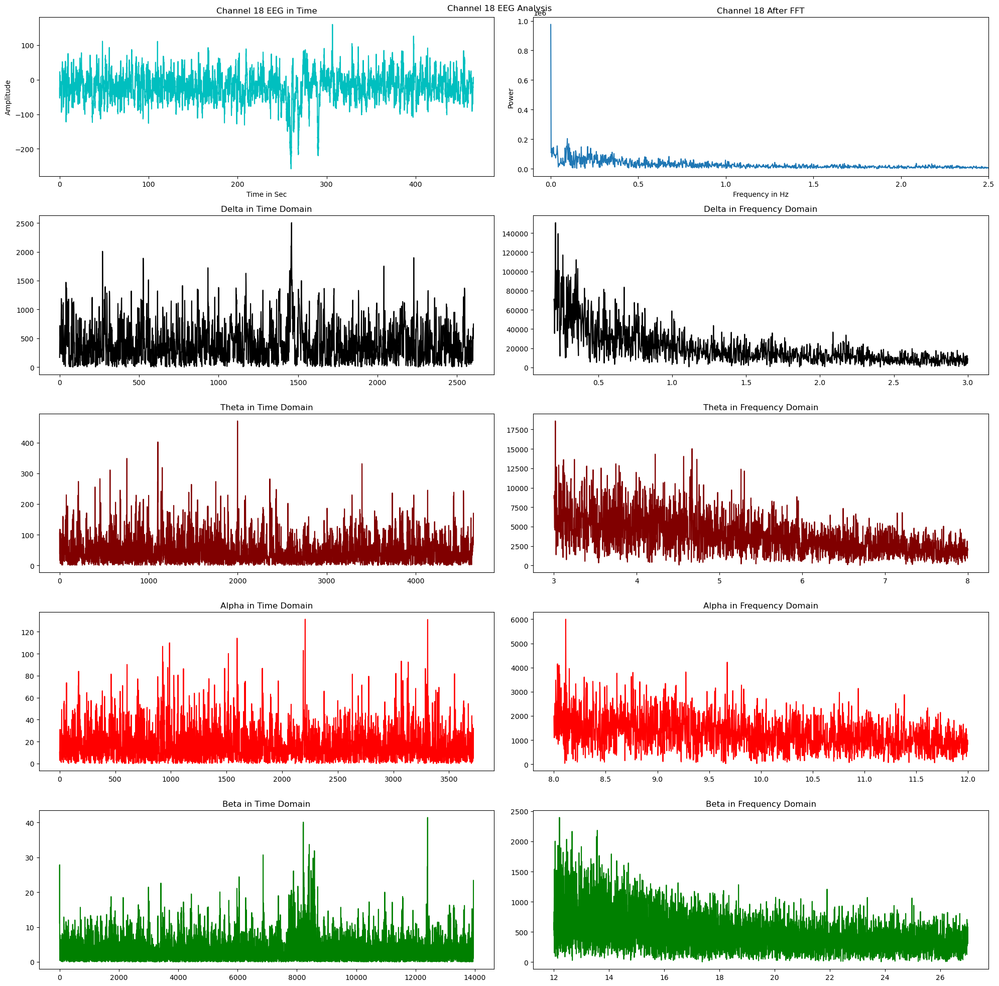

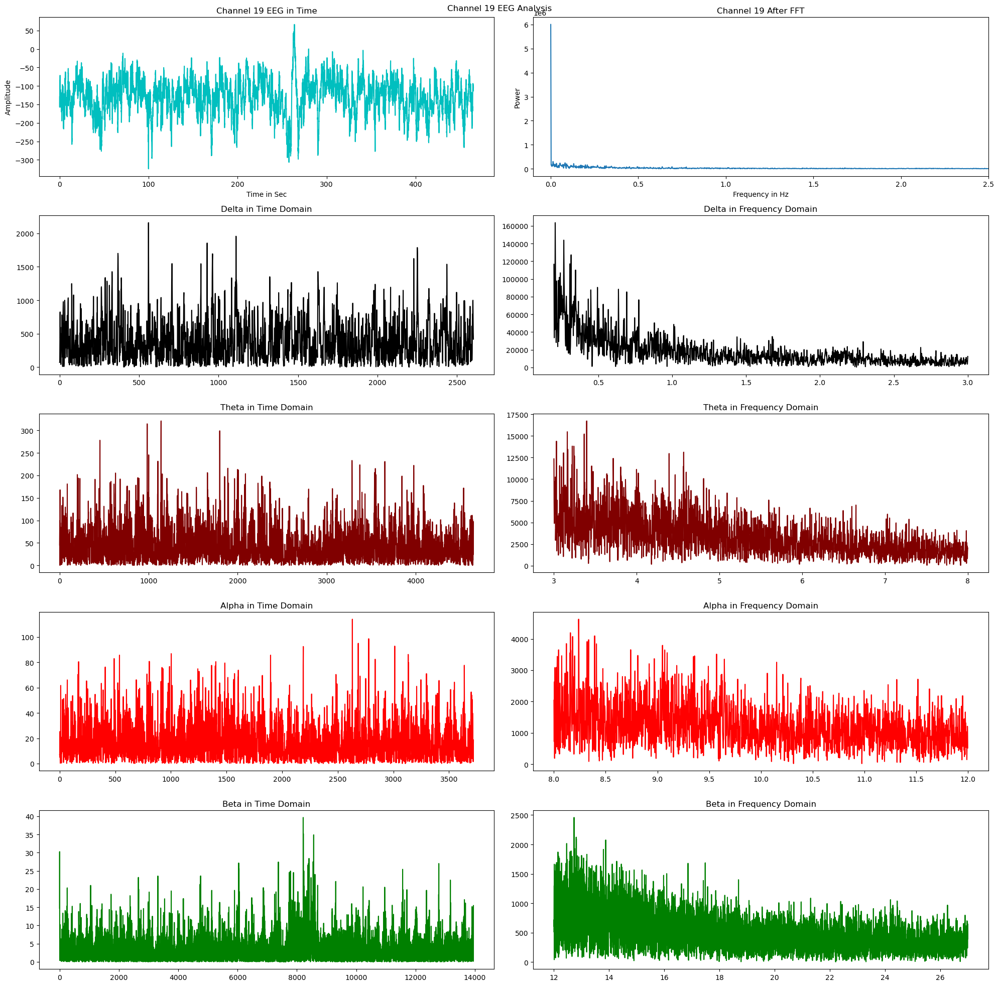

In [55]:
import numpy as np
import matplotlib.pyplot as plt

def plot_channel(xf, yf, channel_num):
    fig, axs = plt.subplots(5, 2, figsize=(20, 20))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, eeg_array[channel_num, :], 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    colors = ['#000000', '#800000', '#FF0000', '#008000']
    
    for i, (name, low, high) in enumerate([('Delta', 0.2, 3), ('Theta', 3, 8), ('Alpha', 8, 12), ('Beta', 12, 27)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

    plt.tight_layout()
    plt.show()

# Compute FFT and plot for each channel
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    plot_channel(xf, yf, i)

In [27]:
def plot_large(x, y, title='', xlabel='', ylabel='', figsize=(10, 6)):
    plt.figure(figsize=figsize)
    plt.plot(x, y)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

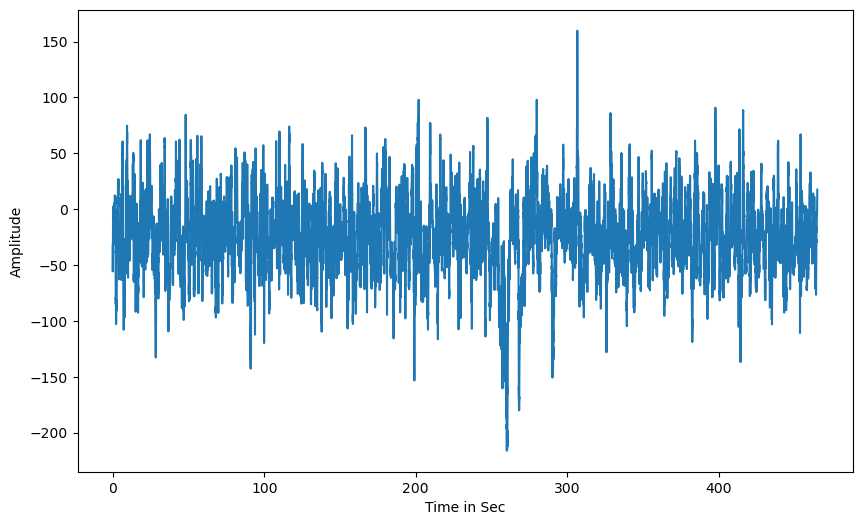

In [30]:
plot_large(time, eeg_array[5], xlabel='Time in Sec', ylabel='Amplitude')

In [43]:
# Example filter data
# Assuming low_pass_filter_data and high_pass_filter_data are arrays representing the frequency response of your filters
# You need to replace these arrays with your actual filter data

# Generate example low-pass filter data
low_pass_cutoff_freq = 30  # Specify the cutoff frequency of your low-pass filter
low_pass_filter_data = np.zeros_like(xf)
low_pass_filter_data[xf <= low_pass_cutoff_freq] = 1

# Generate example high-pass filter data
high_pass_cutoff_freq = 1  # Specify the cutoff frequency of your high-pass filter
high_pass_filter_data = np.zeros_like(xf)
high_pass_filter_data[xf >= high_pass_cutoff_freq] = 1

# Define your filters
filters = {
    'Low Pass': (xf, low_pass_filter_data),
    'High Pass': (xf, high_pass_filter_data),
    # Add more filters as needed
}


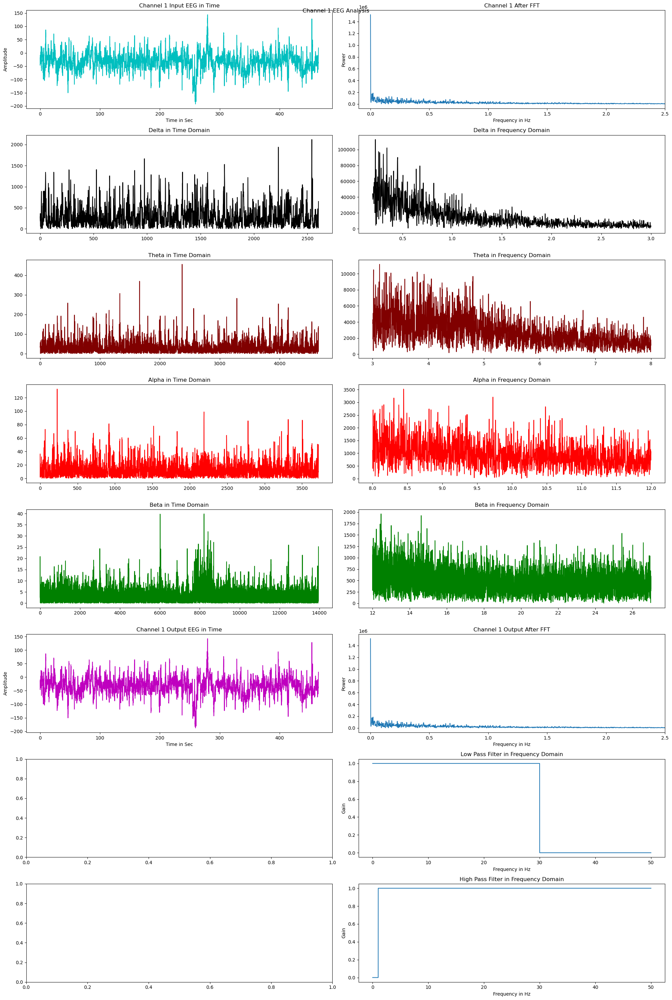

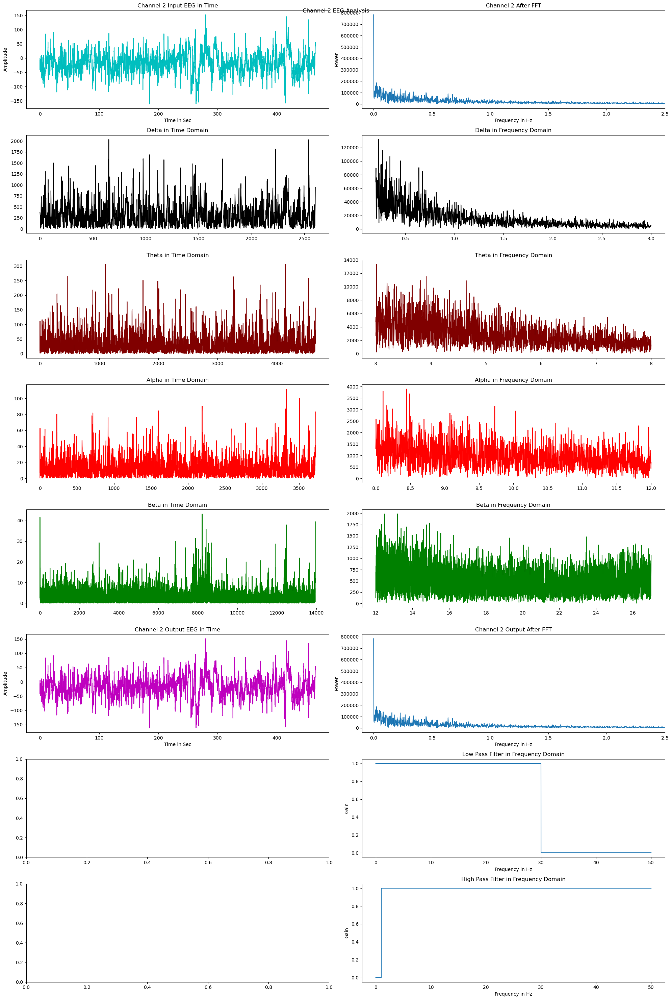

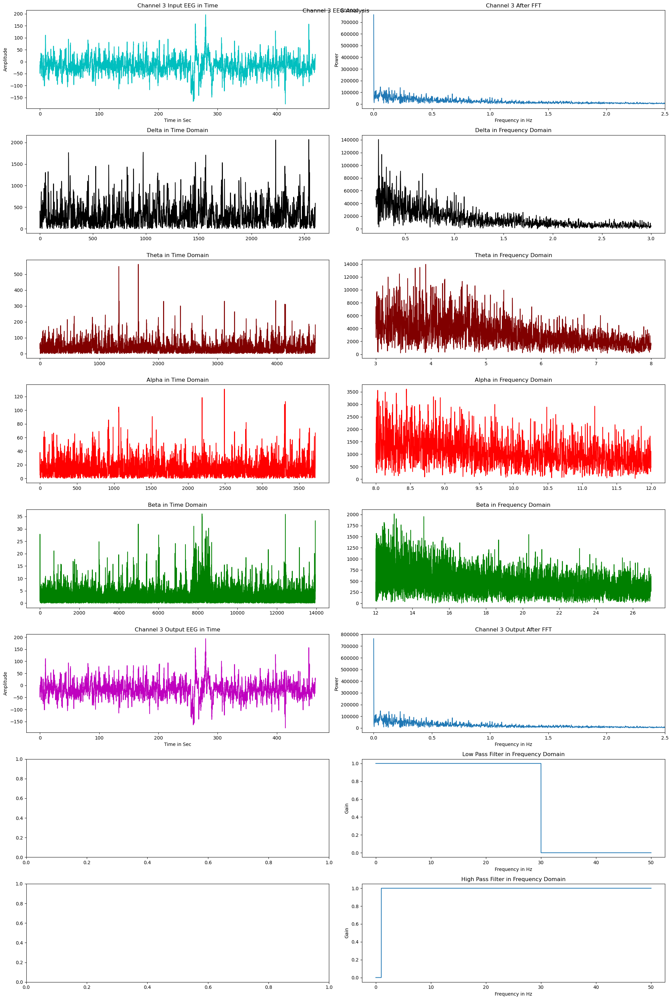

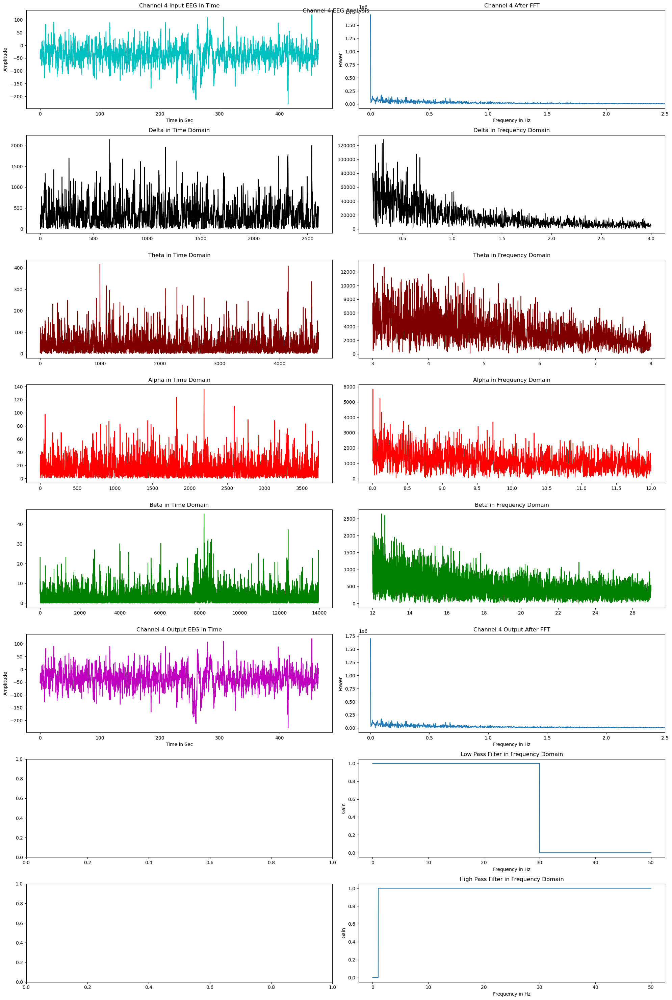

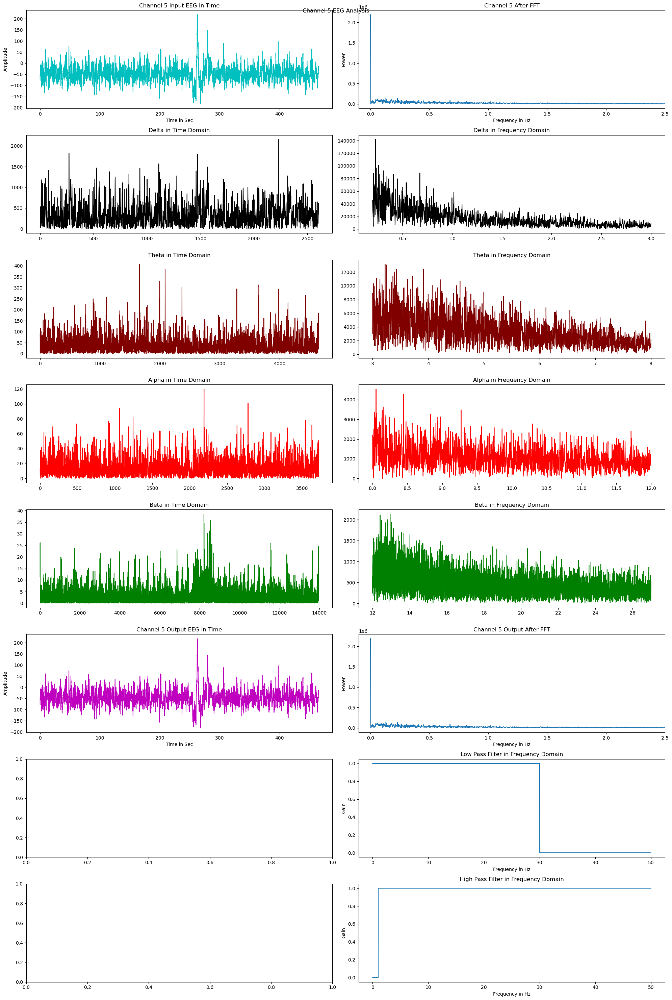

...

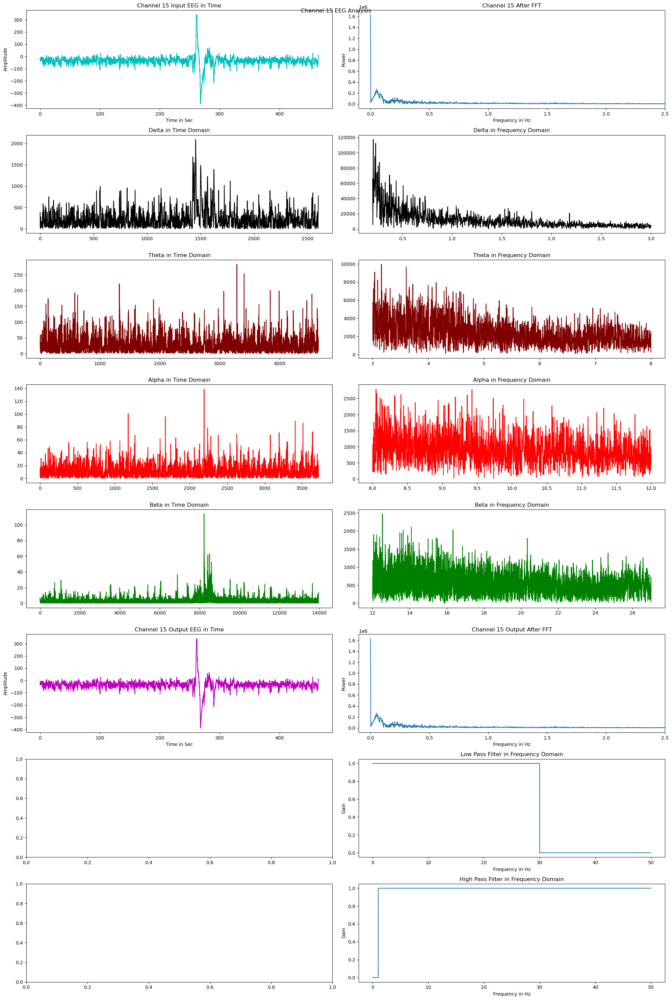

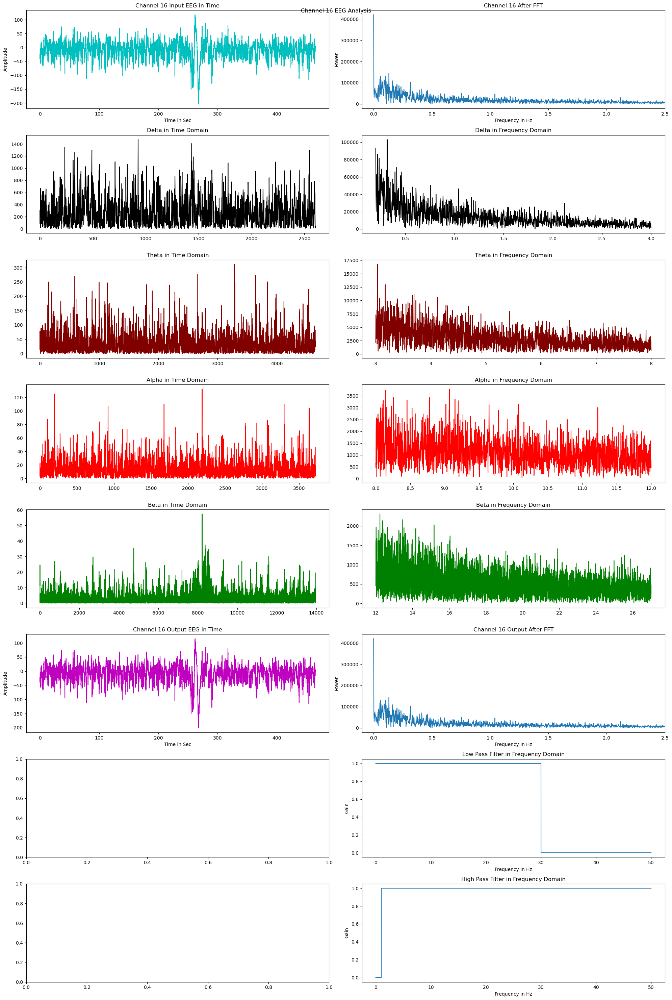

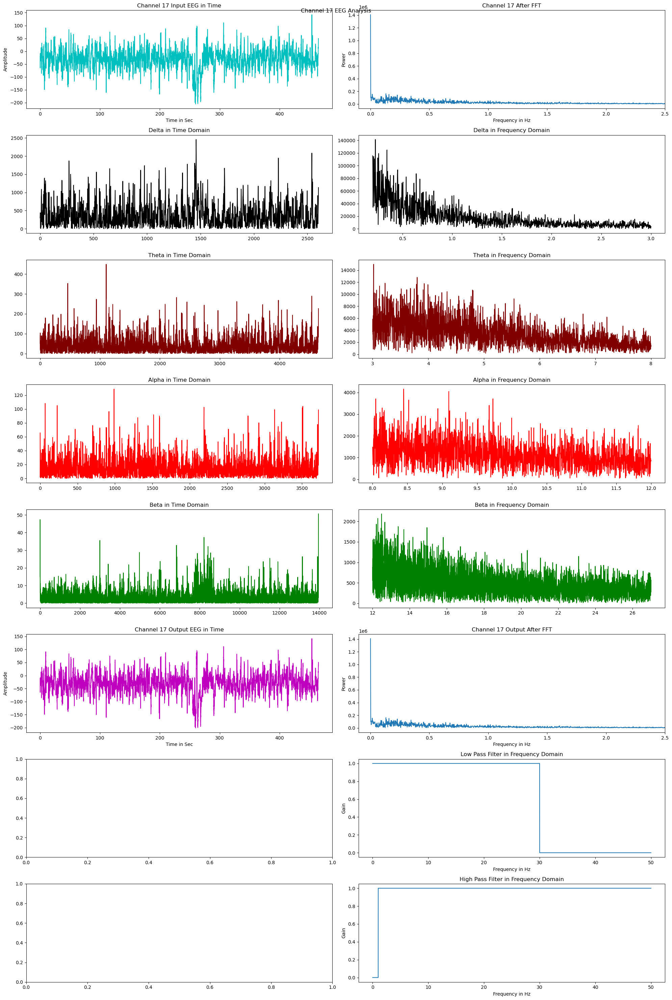

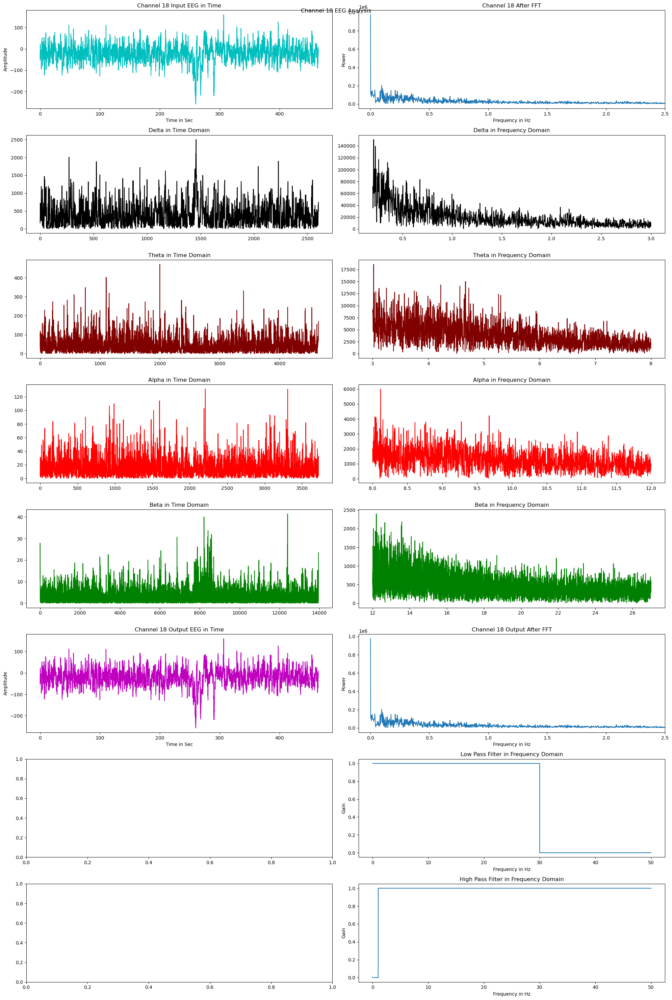

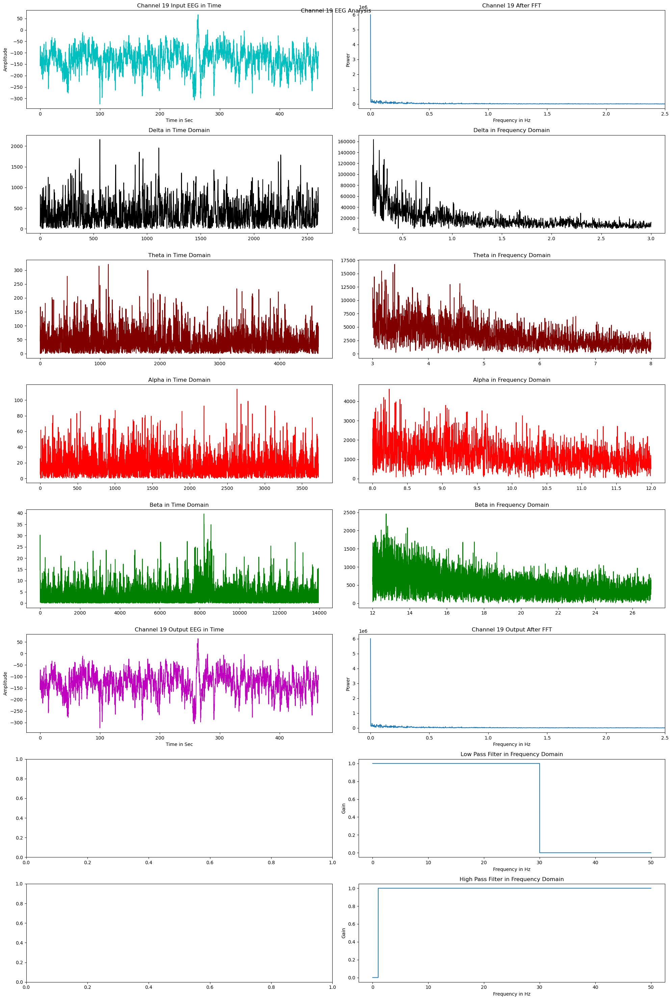

In [46]:
import numpy as np
import matplotlib.pyplot as plt

def plot_channel(xf, yf, channel_num, input_signal, output_signal, filters=None):
    fig, axs = plt.subplots(8, 2, figsize=(20, 30))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, input_signal, 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} Input EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    colors = ['#000000', '#800000', '#FF0000', '#008000']
    
    for i, (name, low, high) in enumerate([('Delta', 0.2, 3), ('Theta', 3, 8), ('Alpha', 8, 12), ('Beta', 12, 27)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

    axs[5, 0].plot(time, output_signal, 'm')
    axs[5, 0].set_title(f'Channel {channel_num + 1} Output EEG in Time')
    axs[5, 0].set_xlabel('Time in Sec')
    axs[5, 0].set_ylabel('Amplitude')

    axs[5, 1].plot(xf, np.abs(np.fft.rfft(output_signal)))
    axs[5, 1].set_title(f'Channel {channel_num + 1} Output After FFT')
    axs[5, 1].set_xlabel('Frequency in Hz')
    axs[5, 1].set_ylabel('Power')
    axs[5, 1].set_xlim(-0.1, 2.5)

    # Plot filters if provided
    if filters is not None:
        for i, (name, filter_data) in enumerate(filters.items()):
            axs[6+i, 1].plot(filter_data[0], np.abs(filter_data[1]), label=name)
            axs[6+i, 1].set_title(f'{name} Filter in Frequency Domain')
            axs[6+i, 1].set_xlabel('Frequency in Hz')
            axs[6+i, 1].set_ylabel('Gain')

    plt.tight_layout()
    plt.show()

# Assuming you have defined num_channels, time, and eeg_array
# Define your filters, for example:
filters = {
    'Low Pass': (xf, low_pass_filter_data),  # low_pass_filter_data contains your filter response
    'High Pass': (xf, high_pass_filter_data),  # high_pass_filter_data contains your filter response
    # Add more filters as needed
}

# Compute FFT and plot for each channel
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    # Assuming you have input and output signals for each channel
    input_signal = eeg_array[i]
    
    # Apply some processing or filtering to get the output signal
    # For example, you can filter the input signal using your defined filters
    output_signal = np.fft.irfft(yf * low_pass_filter_data)  # Example: apply low-pass filter

    plot_channel(xf, yf, i, input_signal, output_signal, filters)


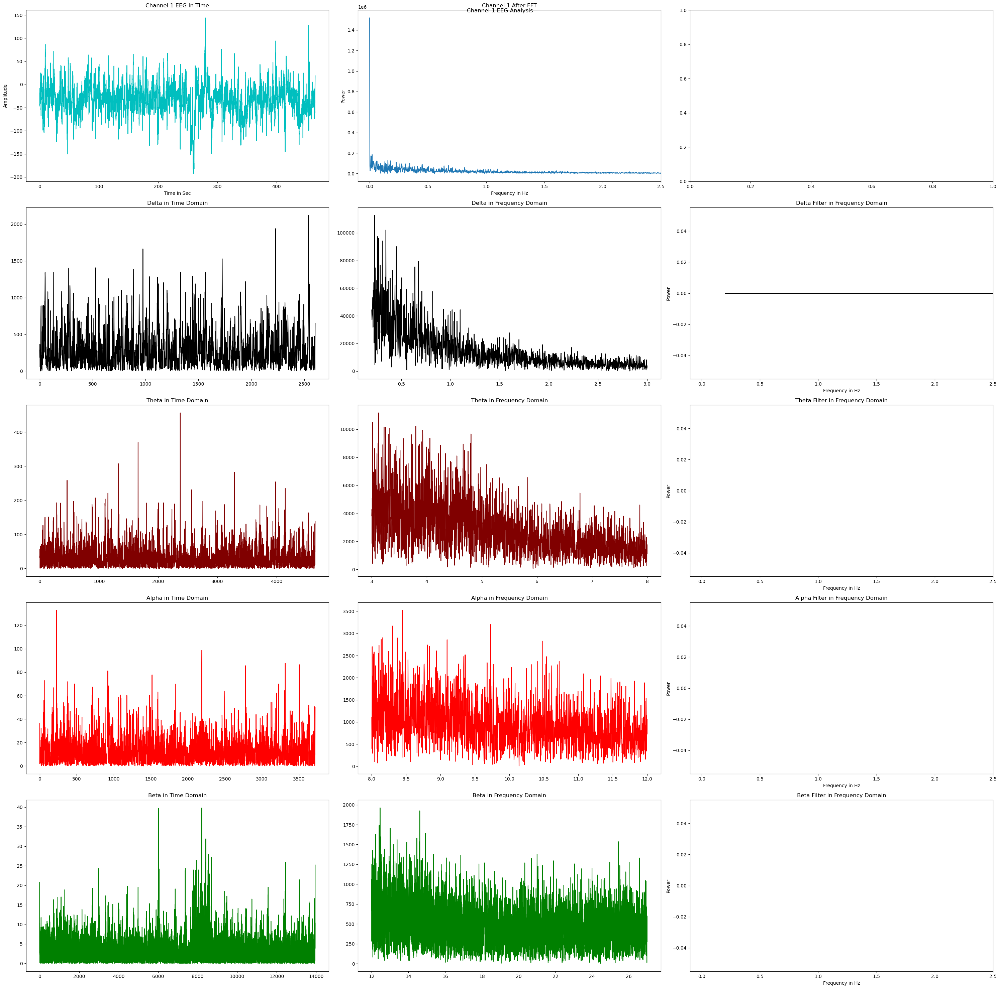

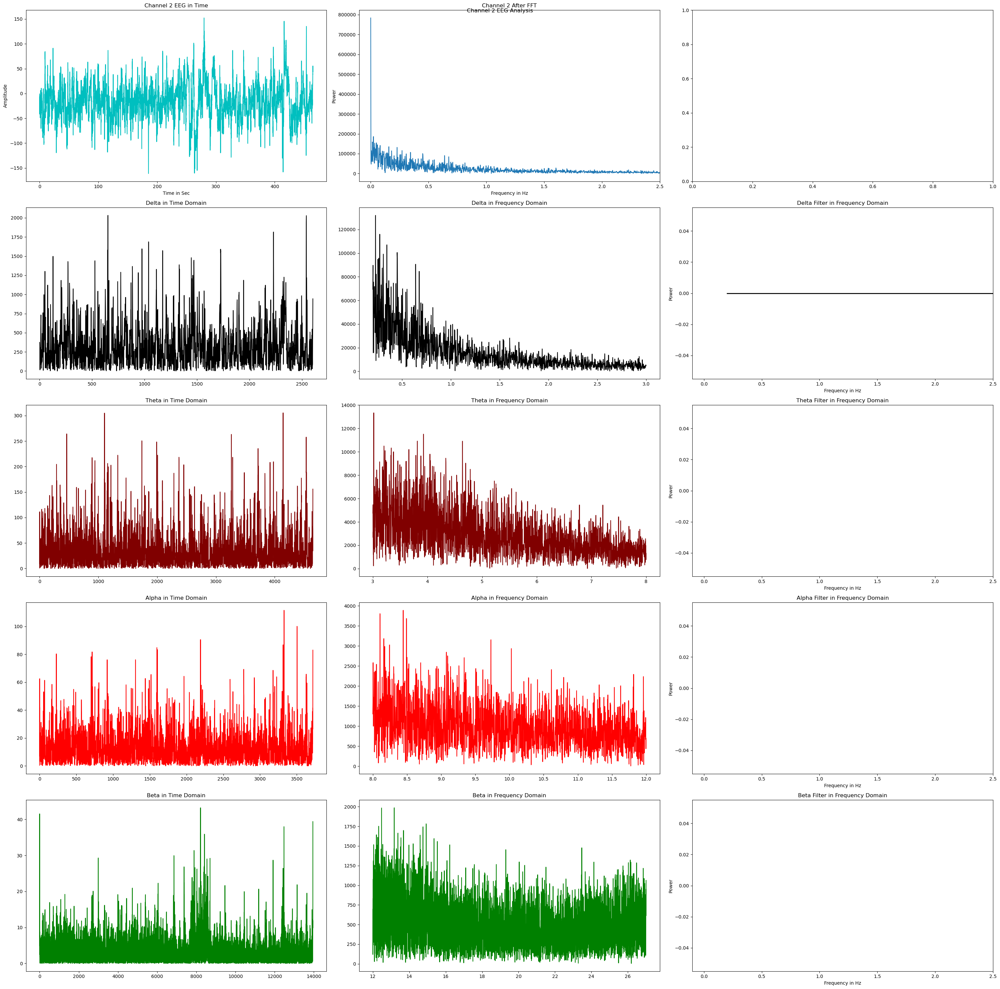

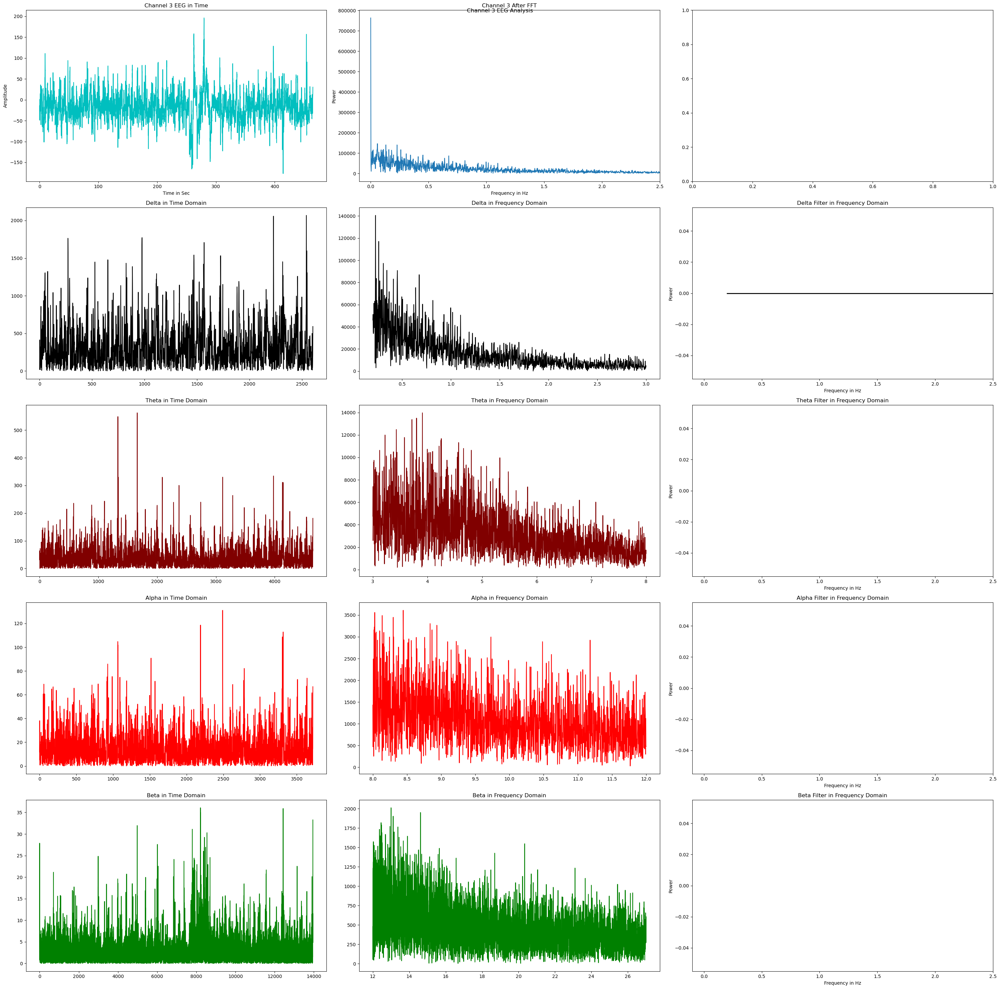

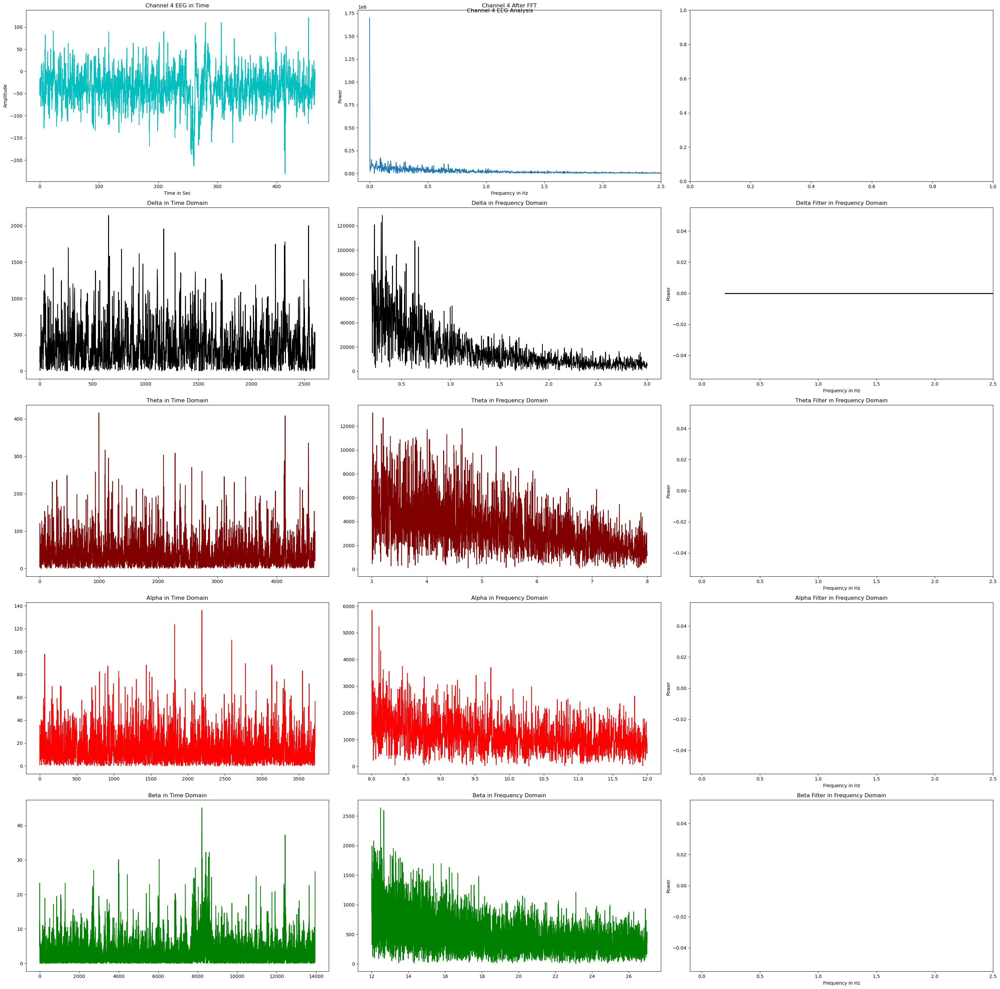

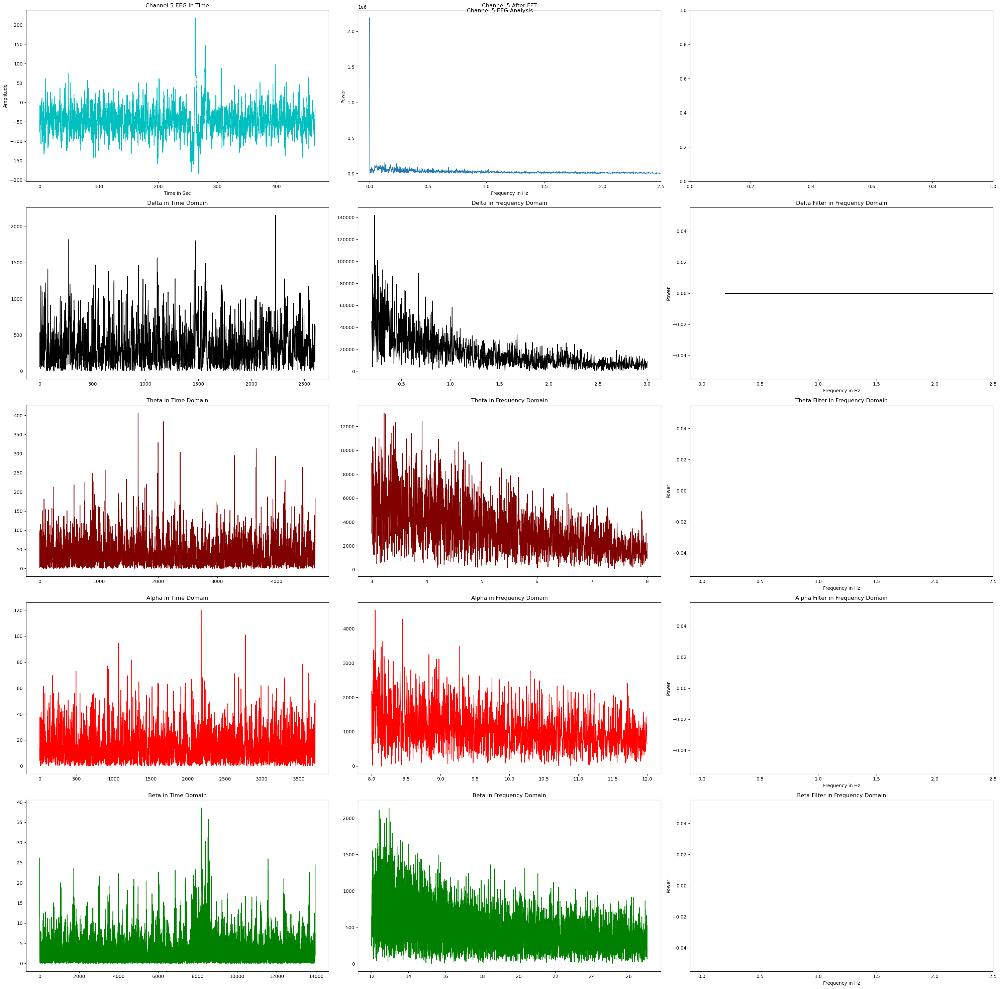

...

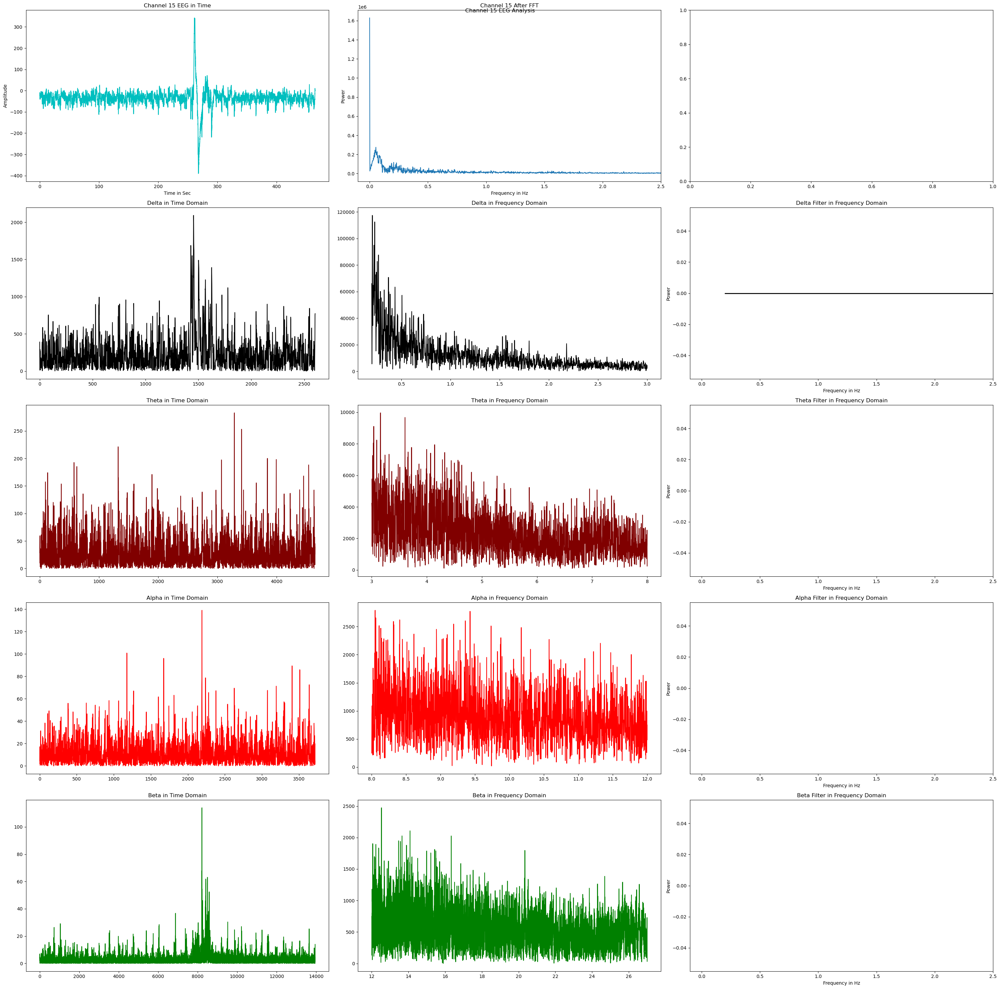

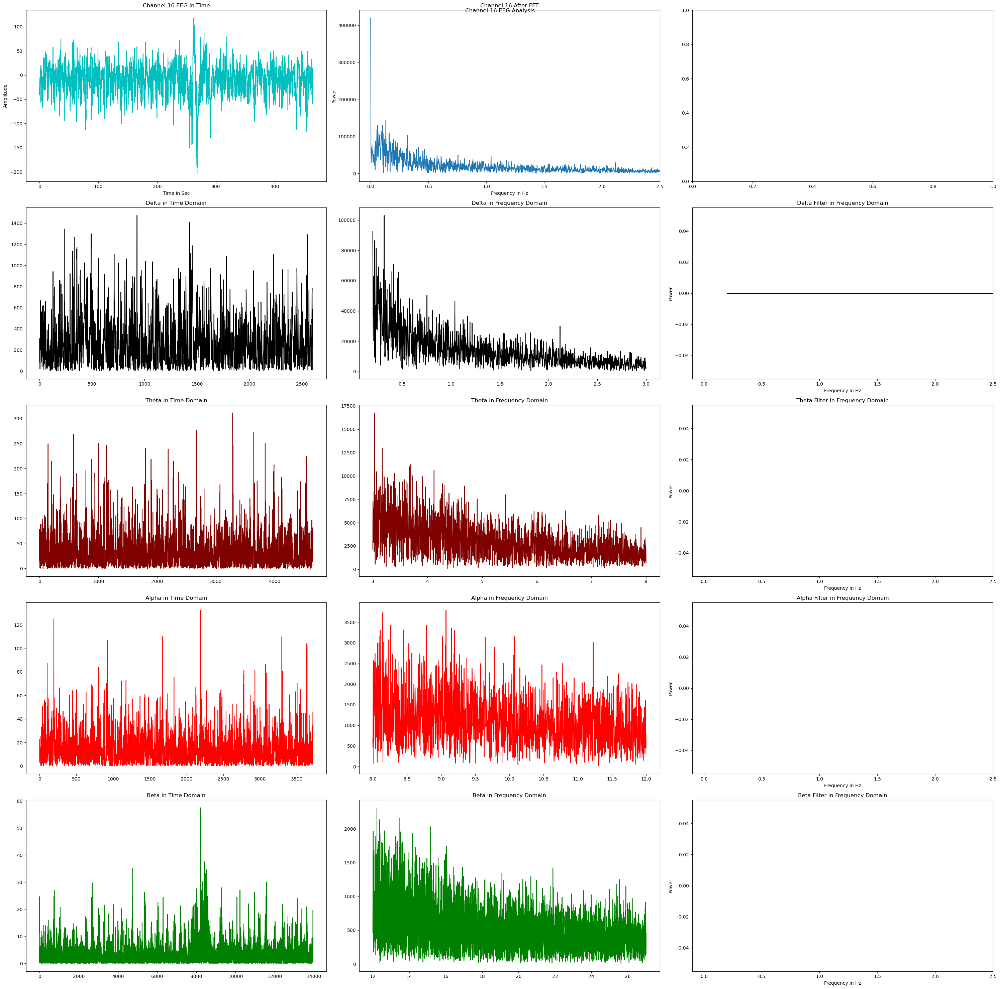

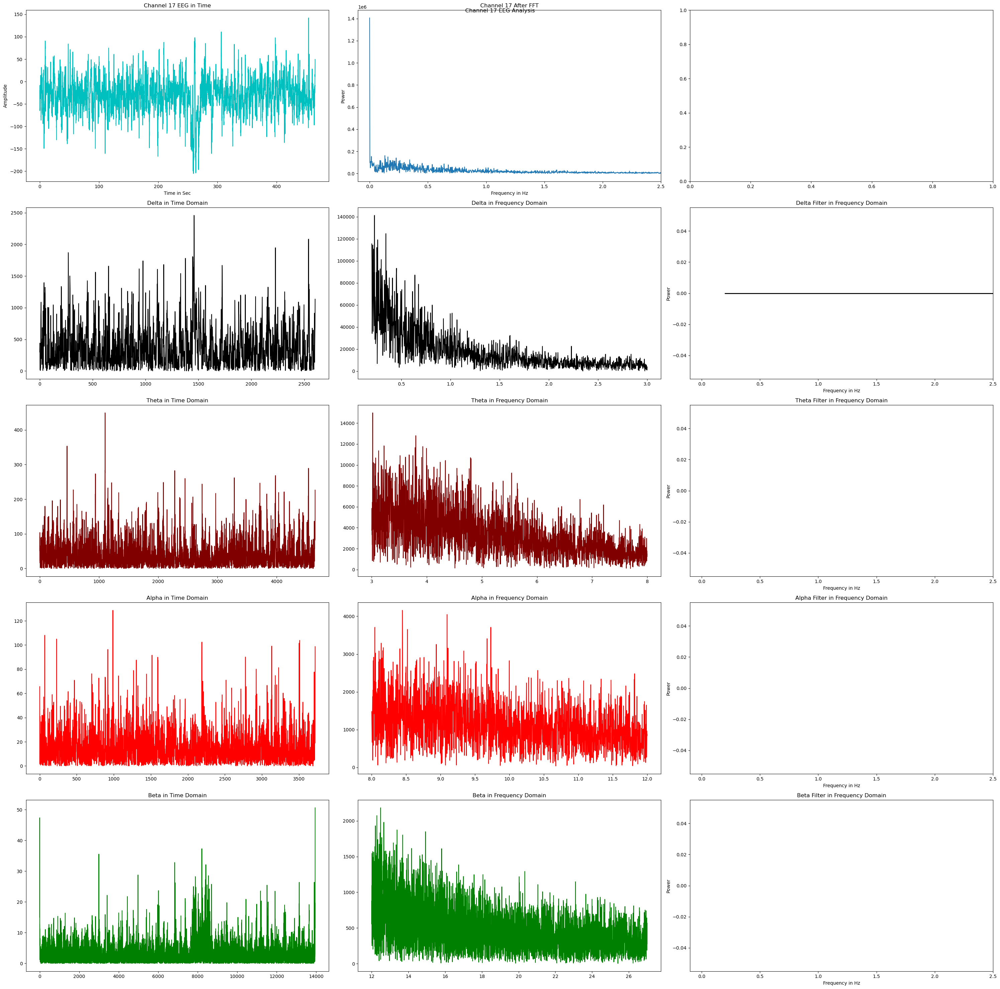

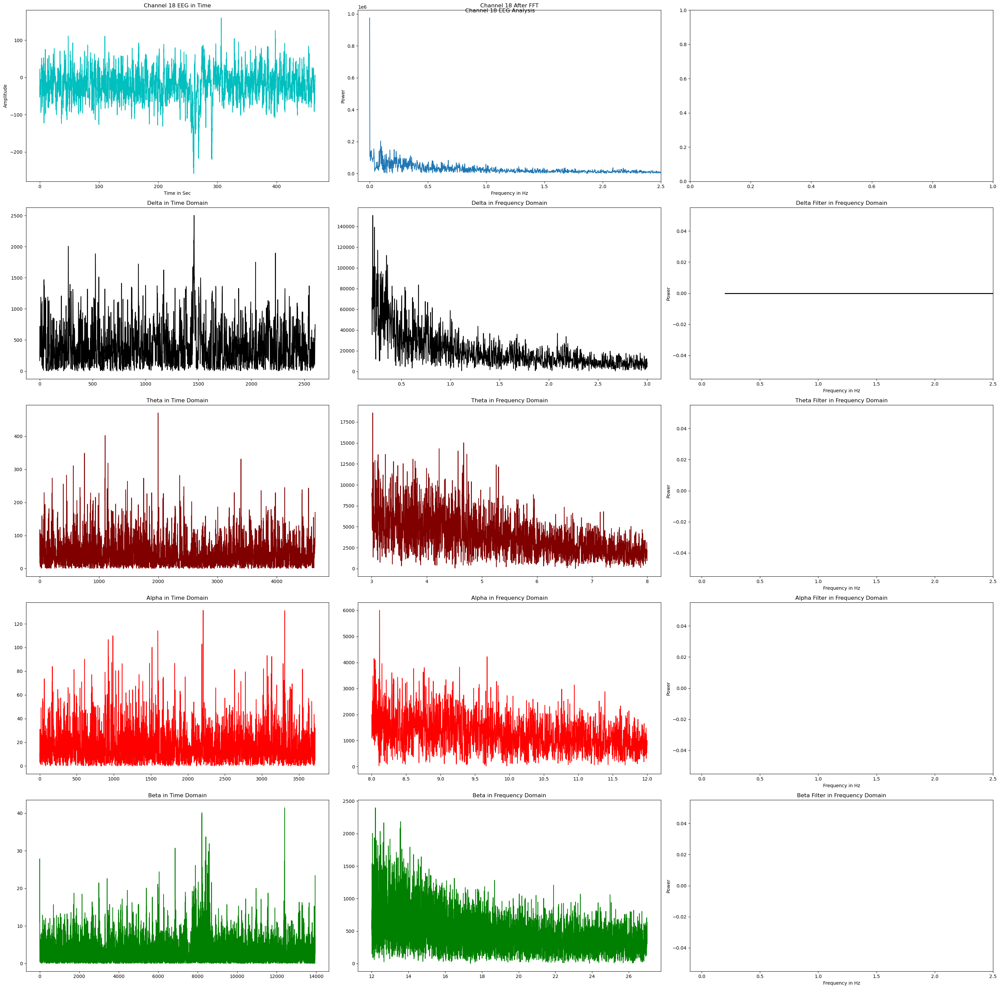

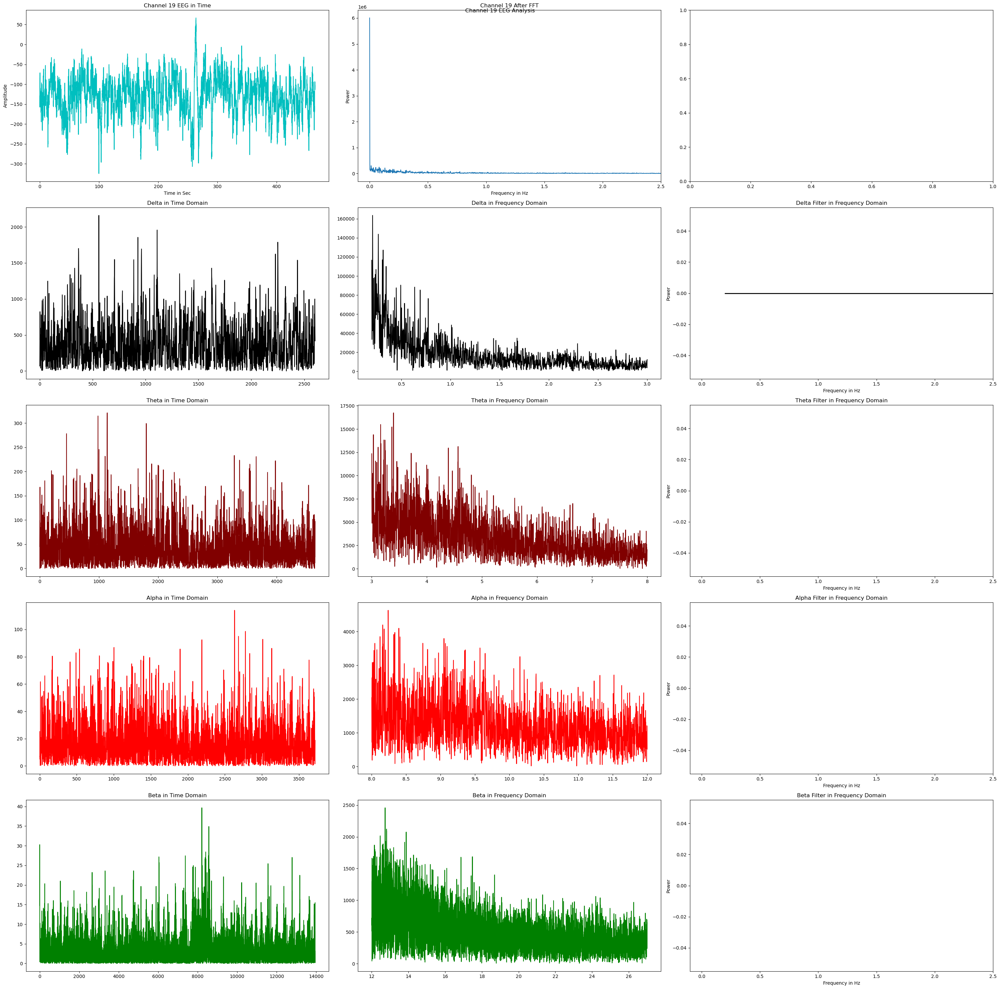

In [42]:
import numpy as np
import matplotlib.pyplot as plt

def plot_channel(xf, yf, channel_num, colors):
    fig, axs = plt.subplots(5, 3, figsize=(30, 30))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, eeg_array[channel_num, :], 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    for i, (name, low, high) in enumerate([('Delta', 0.2, 3), ('Theta', 3, 8), ('Alpha', 8, 12), ('Beta', 12, 27)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

        # Plot filters in frequency domain
        axs[i+1, 2].plot([low, high], [0, 0], colors[i], linewidth=2, label=name)
        axs[i+1, 2].set_title(f'{name} Filter in Frequency Domain')
        axs[i+1, 2].set_xlabel('Frequency in Hz')
        axs[i+1, 2].set_ylabel('Power')
        axs[i+1, 2].set_xlim(-0.1, 2.5)

    plt.tight_layout()
    plt.show()

# Compute FFT and plot for each channel
colors = ['#000000', '#800000', '#FF0000', '#008000']
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    plot_channel(xf, yf, i, colors)

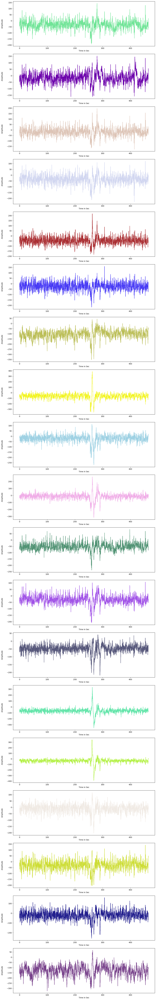

In [53]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, irfft, rfftfreq

# Load EEG data
eeg = np.load('/home/nalin/Downloads/eeg_data_files-20240411/57_00002656_none_montage_False.npy')
eeg_array = np.asarray(eeg)

# Get number of channels and time points
num_channels, num_time_points = eeg_array.shape
time = np.arange(num_time_points) / 100.0

# Plot EEG data for each channel
fig, axs = plt.subplots(num_channels, 1, figsize=(12, 4 * num_channels))
for channel in range(num_channels):
    axs[channel].plot(time, eeg_array[channel, :], c=np.random.rand(3))
    axs[channel].set_ylabel(f'Channel {channel + 1}', labelpad=20)
    axs[channel].set_ylabel(f'Amplitude')
    axs[channel].set_xlabel('Time in Sec')
plt.tight_layout()
plt.show()

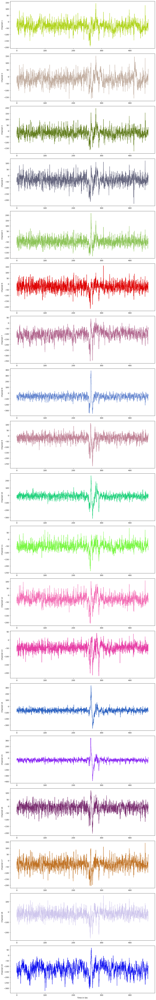

In [54]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, irfft, rfftfreq

# Load EEG data
eeg = np.load('/home/nalin/Downloads/eeg_data_files-20240411/57_00002656_none_montage_False.npy')
eeg_array = np.asarray(eeg)

# Get number of channels and time points
num_channels, num_time_points = eeg_array.shape
time = np.arange(num_time_points) / 100.0

# Plot EEG data for each channel
fig, axs = plt.subplots(num_channels, 1, figsize=(12, 4 * num_channels))
for channel in range(num_channels):
    axs[channel].plot(time, eeg_array[channel, :], c=np.random.rand(3))
    axs[channel].set_ylabel(f'Channel {channel + 1}')
plt.xlabel('Time in Sec')
plt.tight_layout()
plt.show()